# Natural Language Processing Methodology

![png](Images/data_cycle.png)

## Business Understanding

**Objectives of the Project**

    1. Summarize provider notes
    2. Control length of summaries (50,100, or 150 word)
    3. Label the specialty of the note
    4. Topic recognition (i.e, medication name, diagnosis)              

## Data Collection

    Hospital database

## Data Cleaning

    1. Remove unnecessary columns
    2. Handle duplicate values
    3. Handle missing values
    4. Handle inconsistent values in columns that are not text data
    5. Preprocess text data
        - Expand contractions
        - convert to lowercase
        - remove digits
        - remove punctuation
        - remove stop words

# Exploratory Data (text) Analysis

    1. Load cleaned data
    2. Create Document Term Matrix
    3. Generate word clouds
       - All text combined
       - Each specialty
    4. Count plots for word frequencies

# Imports

In [3]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import CountVectorizer
from wordcloud import WordCloud
from textwrap import wrap

# Functions

In [4]:
## Word count
def word_count(text):
    words = text.split()
    return len(words)

# Load Data

In [5]:
data = pd.read_csv('Data/preprocessed_text_data.csv')
data.head()

,Unnamed: 0,medical_specialty,sample_name,transcription,cleaned_transcription
0,0,Allergy / Immunology,Allergic Rhinitis,"SUBJECTIVE:, This 23-year-old white female pr...",subjective 23yearold white female present comp...
1,1,Bariatrics,Laparoscopic Gastric Bypass Consult,"PAST MEDICAL HISTORY:, He has difficulty climb...",past medical history difficulty climb stair di...
2,2,Bariatrics,Laparoscopic Gastric Bypass Consult,"HISTORY OF PRESENT ILLNESS: , I have seen ABC ...",history present illness see abc today pleasant...
3,3,Cardiovascular / Pulmonary,2,"2-D M-MODE: , ,1. Left atrial enlargement wit...",2d mmode leave atrial enlargement leave atrial...
4,4,Cardiovascular / Pulmonary,2,1. The left ventricular cavity size and wall ...,leave ventricular cavity size wall thickness a...


In [6]:
# Remove Unnamed and sample_name column
data.drop(columns=['Unnamed: 0','sample_name'], inplace=True)
data.head()

,medical_specialty,transcription,cleaned_transcription
0,Allergy / Immunology,"SUBJECTIVE:, This 23-year-old white female pr...",subjective 23yearold white female present comp...
1,Bariatrics,"PAST MEDICAL HISTORY:, He has difficulty climb...",past medical history difficulty climb stair di...
2,Bariatrics,"HISTORY OF PRESENT ILLNESS: , I have seen ABC ...",history present illness see abc today pleasant...
3,Cardiovascular / Pulmonary,"2-D M-MODE: , ,1. Left atrial enlargement wit...",2d mmode leave atrial enlargement leave atrial...
4,Cardiovascular / Pulmonary,1. The left ventricular cavity size and wall ...,leave ventricular cavity size wall thickness a...


# Basic Statistical Analysis of Documents and Corpus

In [9]:
## Calculate word counts for each document
word_counts_per_document = [word_count(doc) for doc in data['cleaned_transcription']]
word_counts_per_document

[109,
 237,
 439,
 53,
 163,
 393,
 345,
 72,
 134,
 52,
 108,
 57,
 340,
 330,
 264,
 162,
 515,
 119,
 176,
 134,
 72,
 191,
 80,
 128,
 2,
 55,
 119,
 71,
 119,
 83,
 111,
 330,
 132,
 124,
 152,
 70,
 206,
 170,
 171,
 323,
 259,
 311,
 79,
 780,
 205,
 173,
 248,
 638,
 363,
 244,
 424,
 559,
 372,
 163,
 85,
 487,
 173,
 598,
 212,
 98,
 109,
 353,
 735,
 147,
 236,
 73,
 149,
 330,
 445,
 329,
 122,
 271,
 347,
 92,
 102,
 314,
 215,
 330,
 328,
 271,
 86,
 152,
 305,
 447,
 89,
 180,
 250,
 404,
 376,
 134,
 422,
 249,
 390,
 127,
 220,
 232,
 210,
 68,
 172,
 208,
 118,
 285,
 269,
 293,
 350,
 379,
 255,
 260,
 342,
 626,
 338,
 339,
 172,
 259,
 194,
 171,
 194,
 257,
 255,
 96,
 158,
 259,
 67,
 54,
 101,
 36,
 118,
 133,
 411,
 200,
 293,
 119,
 78,
 182,
 218,
 196,
 276,
 224,
 327,
 314,
 9,
 243,
 173,
 260,
 144,
 201,
 181,
 1111,
 84,
 52,
 135,
 78,
 130,
 242,
 116,
 268,
 190,
 66,
 129,
 121,
 117,
 222,
 121,
 309,
 9,
 166,
 79,
 91,
 115,
 744,
 292,
 192,
 5

In [11]:
## Calculate total word count for the whole corpus
total_word_count = sum(word_counts_per_document)

## Calculate minimum, maximum, and average word counts
min_word_count = min(word_counts_per_document)
max_word_count = max(word_counts_per_document)
average_word_count = total_word_count / len(data['cleaned_transcription'])

## Print results
print("Total word count for the entire corpus:", total_word_count)
print("Minimum word count for a document:", min_word_count)
print("Maximum word count for a document:", max_word_count)
print("Average word count for the documents:", round(average_word_count))

Total word count for the entire corpus: 1358346
Minimum word count for a document: 1
Maximum word count for a document: 1707
Average word count for the documents: 275


# Document Term Matrix

In [4]:
## Group rows by medical specialty
specialty_grp = data[['medical_specialty','cleaned_transcription']].groupby(by='medical_specialty').agg(lambda x:' '.join(x))

In [5]:
## Check to see if result is as expected
specialty_grp

,cleaned_transcription
medical_specialty,
Allergy / Immunology,subjective 23yearold white female present comp...
Autopsy,summary clinical history patient 35yearold afr...
Bariatrics,past medical history difficulty climb stair di...
Cardiovascular / Pulmonary,2d mmode leave atrial enlargement leave atrial...
Chiropractic,present complaint patient report ongoing chron...
Consult - History and Phy.,subjective patient present mom first visit off...
Cosmetic / Plastic Surgery,preoperative diagnose nasal obstruction second...
Dentistry,preoperative diagnosis completely bony impact ...
Dermatology,procedure skin biopsy scalp moleindication 66y...


In [6]:
## Document Term Matrix
cv=CountVectorizer(analyzer='word')
data_cv=cv.fit_transform(specialty_grp['cleaned_transcription'])
df_dtm = pd.DataFrame(data_cv.toarray(), columns=cv.get_feature_names_out())
df_dtm.index=specialty_grp.index
df_dtm.head(10)

,00,000,0000000dear,0010,0030,004,0048,005,00fio2,00gestational,...,zygomatic,zygomawe,zyloprim,zymar,zyprexa,zyprexasocial,zyrtec,zyrtecallergie,zyrtecsurgerie,zyvox
medical_specialty,,,,,,,,,,,,,,,,,,,,,
Allergy / Immunology,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,2,0,0,0
Autopsy,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Bariatrics,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Cardiovascular / Pulmonary,2,2,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,2,1,0,2
Chiropractic,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Consult - History and Phy.,7,0,0,2,0,3,0,2,0,0,...,1,0,1,0,6,1,16,1,1,1
Cosmetic / Plastic Surgery,0,0,0,0,0,0,0,0,0,0,...,2,1,0,0,0,0,0,0,0,0
Dentistry,0,1,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
Dermatology,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0


In [7]:
# Transposing document term matrix
df_dtm=df_dtm.transpose()
df_dtm.head()

medical_specialty,Allergy / Immunology,Autopsy,Bariatrics,Cardiovascular / Pulmonary,Chiropractic,Consult - History and Phy.,Cosmetic / Plastic Surgery,Dentistry,Dermatology,Diets and Nutritions,...,Pediatrics - Neonatal,Physical Medicine - Rehab,Podiatry,Psychiatry / Psychology,Radiology,Rheumatology,Sleep Medicine,Speech - Language,Surgery,Urology
00,0,0,0,2,0,7,0,0,0,0,...,0,0,0,0,6,0,6,0,10,4
000,0,0,0,2,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,8,3
0000000dear,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,1
0010,0,0,0,0,0,2,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
0030,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0


# Word Cloud

In [8]:
# Function for generating word clouds
def generate_wordcloud(data,title):
  wc = WordCloud(width=400, height=330, max_words=50,colormap="Dark2").generate_from_frequencies(data)
  
  plt.imshow(wc, interpolation='bilinear')
  plt.axis("off")
  plt.title('\n'.join(wrap(title,60)),fontsize=13)
  plt.show()

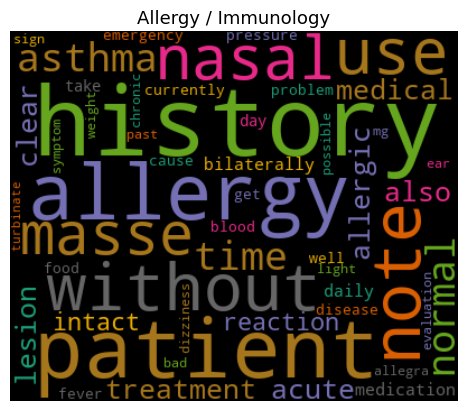

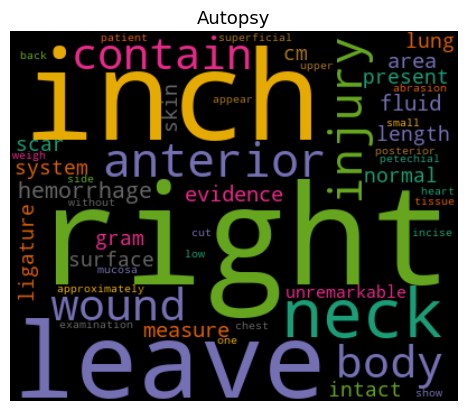

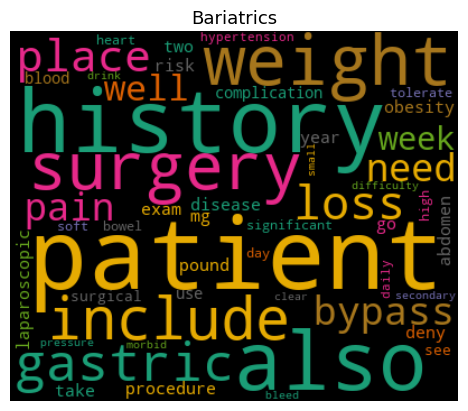

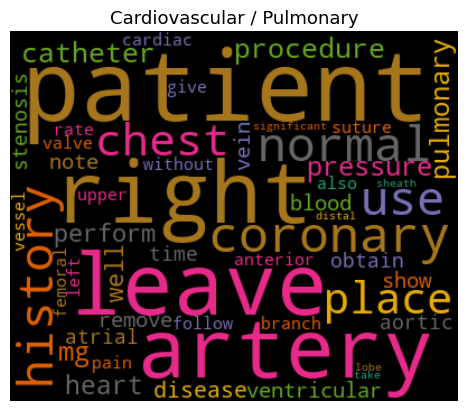

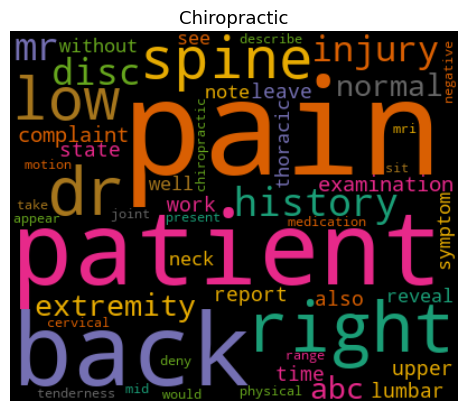

...

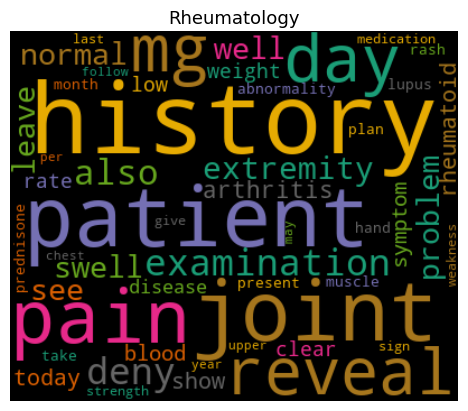

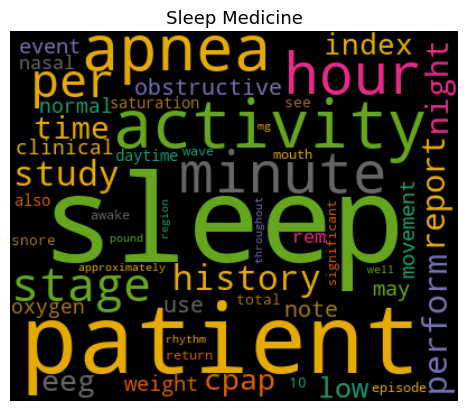

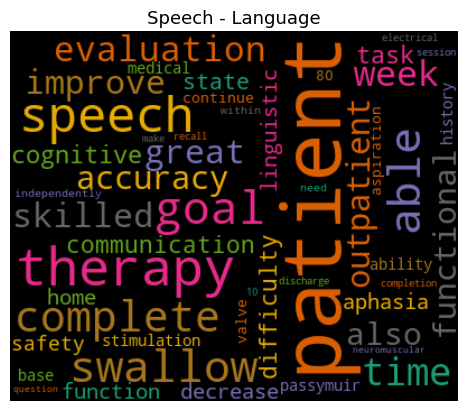

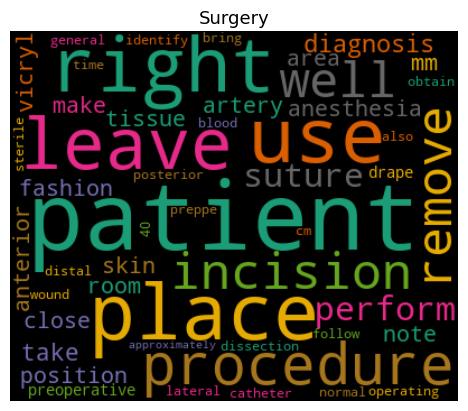

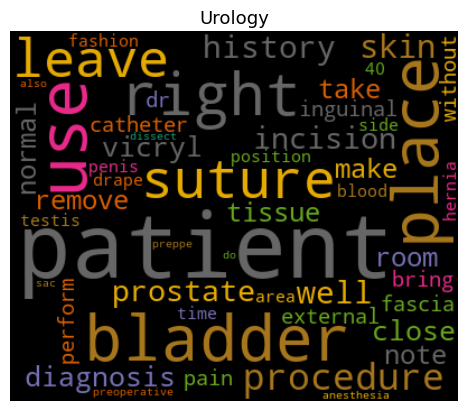

In [9]:
# Plotting word cloud for each product
for index,specialty in enumerate(df_dtm.columns):
  generate_wordcloud(df_dtm[specialty].sort_values(ascending=False),specialty)

In [10]:
## Filter for unclean text
all_text_unclean = data['transcription']
all_text_unclean.head()

0    SUBJECTIVE:,  This 23-year-old white female pr...
1    PAST MEDICAL HISTORY:, He has difficulty climb...
2    HISTORY OF PRESENT ILLNESS: , I have seen ABC ...
3    2-D M-MODE: , ,1.  Left atrial enlargement wit...
4    1.  The left ventricular cavity size and wall ...
Name: transcription, dtype: object

In [11]:
## Filter for clean text
all_text_clean = data['cleaned_transcription']
all_text_clean.head()

0    subjective 23yearold white female present comp...
1    past medical history difficulty climb stair di...
2    history present illness see abc today pleasant...
3    2d mmode leave atrial enlargement leave atrial...
4    leave ventricular cavity size wall thickness a...
Name: cleaned_transcription, dtype: object

In [12]:
# Combine all unclean text into a single string
combined_text_unclean = ' '.join(all_text_unclean)
combined_text_unclean

'SUBJECTIVE:,  This 23-year-old white female presents with complaint of allergies.  She used to have allergies when she lived in Seattle but she thinks they are worse here.  In the past, she has tried Claritin, and Zyrtec.  Both worked for short time but then seemed to lose effectiveness.  She has used Allegra also.  She used that last summer and she began using it again two weeks ago.  It does not appear to be working very well.  She has used over-the-counter sprays but no prescription nasal sprays.  She does have asthma but doest not require daily medication for this and does not think it is flaring up.,MEDICATIONS: , Her only medication currently is Ortho Tri-Cyclen and the Allegra.,ALLERGIES: , She has no known medicine allergies.,OBJECTIVE:,Vitals:  Weight was 130 pounds and blood pressure 124/78.,HEENT:  Her throat was mildly erythematous without exudate.  Nasal mucosa was erythematous and swollen.  Only clear drainage was seen.  TMs were clear.,Neck:  Supple without adenopathy.,

In [13]:
# Combine all clean text into a single string
combined_text_clean = ' '.join(all_text_clean)
combined_text_clean

'subjective 23yearold white female present complaint allergy use allergy live seattle think bad past try claritin zyrtec work short time seem lose effectiveness use allegra also use last summer begin use two week ago appear work well use overthecounter spray prescription nasal spray asthma doest require daily medication think flare upmedication medication currently ortho tricyclen allegraallergie know medicine allergiesobjectivevital weight 130 pound blood pressure 12478.heent throat mildly erythematous without exudate nasal mucosa erythematous swollen clear drainage see tms clearneck supple without adenopathylung clearassessment allergic rhinitisplan try zyrtec instead allegra another option use loratadine think prescription coverage might cheap sample nasonex two spray nostril give three week prescription write well past medical history difficulty climb stair difficulty airline seat tie shoe use public seating lifting object floor exercise three time week home cardio difficulty walk 

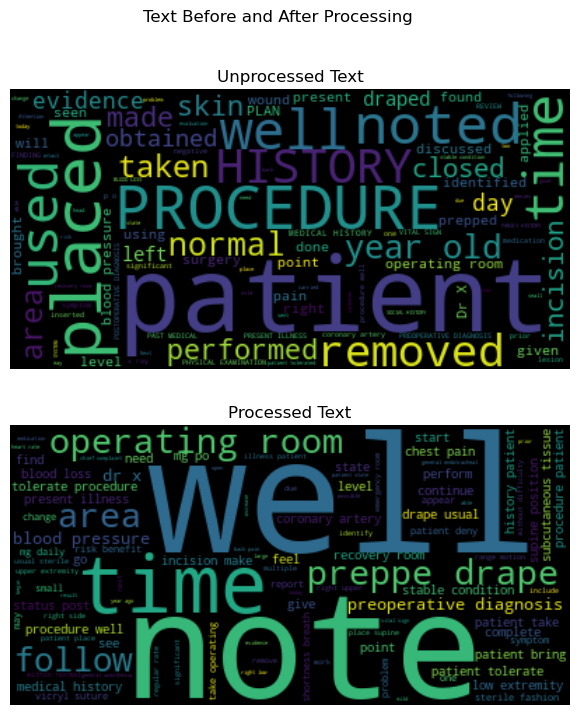

In [14]:
# Create and generate a word cloud image:
wordcloud_unclean = WordCloud(max_words=100).generate(combined_text_unclean)
wordcloud_clean = WordCloud(max_words=100).generate(combined_text_clean)

# Create subplots
fig, ax = plt.subplots(2, figsize=(10, 8))

# Display the generated image:
fig.suptitle('Text Before and After Processing')
ax[0].imshow(wordcloud_unclean, interpolation='bilinear')
ax[0].axis("off")
ax[0].set_title('Unprocessed Text')
ax[1].imshow(wordcloud_clean, interpolation='bilinear')
ax[1].axis("off")
ax[1].set_title('Processed Text')
plt.show()

count                4943
unique               2353
top       chief complaint
freq                    6
Name: cleaned_transcription, dtype: object